**First part of the code aims to import all packages and dependencies which are going to be used throughout the project, as well as the dataset. Two new augmented datasets are introduced to the original work, to be tested on the model. Basic tests are conducted to ensure all datasets are loaded and prepared properly.**

In [1]:
!pip install wandb
!pip install tensorflow

In [2]:
from IPython.display import clear_output
clear_output()

In [3]:
import os
import random
import numpy as np
from glob import glob
from PIL import Image, ImageOps

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import wandb
from wandb.integration.keras import WandbCallback

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models, Input, callbacks, mixed_precision
from tensorflow.keras.preprocessing import image

# Enable Mixed Precision for Faster Computation
mixed_precision.set_global_policy('mixed_float16')

# Enable TensorFlow XLA JIT Compilation
tf.config.optimizer.set_jit(True)
AUTOTUNE = tf.data.AUTOTUNE

In [4]:
SEED = 10
random.seed(SEED)
tf.random.set_seed(SEED)


IMAGE_SIZE = 256
MAX_TRAIN_IMAGES = 400
BATCH_SIZE = 16
TRAIN_VAL_LOW_DIR = "./lol_dataset/our485/low"
TRAIN_VAL_HIGH_DIR = "./lol_dataset/our485/high"
TEST_LOW_DIR = "./lol_dataset/eval15/low"
TEST_HIGH_DIR = "./lol_dataset/eval15/high"
LEARNING_RATE = 1e-4
LOG_INTERVALS = 10
EPOCHS = 60

In [5]:
train_val_low_files = sorted(glob(os.path.join(TRAIN_VAL_LOW_DIR, "*.png")))
train_val_high_files = sorted(glob(os.path.join(TRAIN_VAL_HIGH_DIR, "*.png")))
test_low_files = sorted(glob(os.path.join(TEST_LOW_DIR, "*.png")))
test_high_files = sorted(glob(os.path.join(TEST_HIGH_DIR, "*.png")))

assert len(train_val_low_files) == len(train_val_high_files), "Mismatch in training pairs"
assert len(test_low_files) == len(test_high_files), "Mismatch in test pairs"

train_low_files = train_val_low_files[:MAX_TRAIN_IMAGES]
train_high_files = train_val_high_files[:MAX_TRAIN_IMAGES]
val_low_files = train_val_low_files[MAX_TRAIN_IMAGES:]
val_high_files = train_val_high_files[MAX_TRAIN_IMAGES:]

print("Number of Training Images:", len(train_low_files))
print("Number of Validation Images:", len(val_low_files))
print("Number of Test Images from LOL Dataset:", len(test_low_files))

Number of Training Images: 400
Number of Validation Images: 85
Number of Test Images from LOL Dataset: 15


In [6]:
def load_data(low_image_path, bright_image_path):
    def preprocess(image_path):
        image = tf.io.read_file(image_path)
        image = tf.image.decode_png(image, channels=3)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.0
        return image

    low_image = preprocess(low_image_path)
    bright_image = preprocess(bright_image_path)
    return low_image, bright_image

# Preparing an augmented dataset using basic transformations to be tested on the model
def basic_augmentation(low_image, bright_image):
    low_image = tf.image.random_brightness(low_image, max_delta=0.2)
    low_image = tf.image.random_flip_left_right(low_image)
    low_image = tf.image.random_flip_up_down(low_image)
    low_image = tf.image.random_crop(low_image, size=[IMAGE_SIZE, IMAGE_SIZE, 3])
    return low_image, bright_image

# Preparing an augmented dataset with modified exposure/lighting to be tested on the model
def exposure_augmentation(low_image, bright_image):
    low_image = tf.image.adjust_brightness(low_image, delta=random.uniform(-0.2, 0.2))
    gamma = random.uniform(0.5, 2.5)
    low_image = tf.image.adjust_gamma(low_image, gamma)
    low_image = tf.image.random_contrast(low_image, lower=0.7, upper=1.3)
    return low_image, bright_image

def get_dataset(low_images, bright_images, augmentation_type=None):
    dataset = tf.data.Dataset.from_tensor_slices((low_images, bright_images))
    dataset = dataset.map(lambda x, y: load_data(x, y), num_parallel_calls=AUTOTUNE)

    if augmentation_type == 'basic':
        dataset = dataset.map(lambda x, y: basic_augmentation(x, y), num_parallel_calls=AUTOTUNE)
    elif augmentation_type == 'exposure':
        dataset = dataset.map(lambda x, y: exposure_augmentation(x, y), num_parallel_calls=AUTOTUNE)

    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    dataset = dataset.prefetch(AUTOTUNE)
    return dataset


# The original dataset
train_dataset_original = get_dataset(train_low_files, train_high_files)
val_dataset_original = get_dataset(val_low_files, val_high_files)
test_dataset = get_dataset(test_low_files, test_high_files)

# Basic and exposure-wise augmented datasets
train_dataset_basic = get_dataset(train_low_files, train_high_files, augmentation_type='basic')
val_dataset_basic = get_dataset(val_low_files, val_high_files, augmentation_type='basic')

train_dataset_exposure = get_dataset(train_low_files, train_high_files, augmentation_type='exposure')
val_dataset_exposure = get_dataset(val_low_files, val_high_files, augmentation_type='exposure')

In [7]:
print("\033[94m")

def print_dataset_info(name, dataset):
    print(f"{name} Data Elements:", dataset.element_spec)

print_dataset_info("Original Train", train_dataset_original)
print_dataset_info("Original Validation", val_dataset_original)
print_dataset_info("Basic Train", train_dataset_basic)
print_dataset_info("Basic Validation", val_dataset_basic)
print_dataset_info("Exposure Train", train_dataset_exposure)
print_dataset_info("Exposure Validation", val_dataset_exposure)


Original Train Data Elements: (TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))
Original Validation Data Elements: (TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))
Basic Train Data Elements: (TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))
Basic Validation Data Elements: (TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))
Exposure Train Data Elements: (TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))
Exposure Validation Data Elements: (TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))


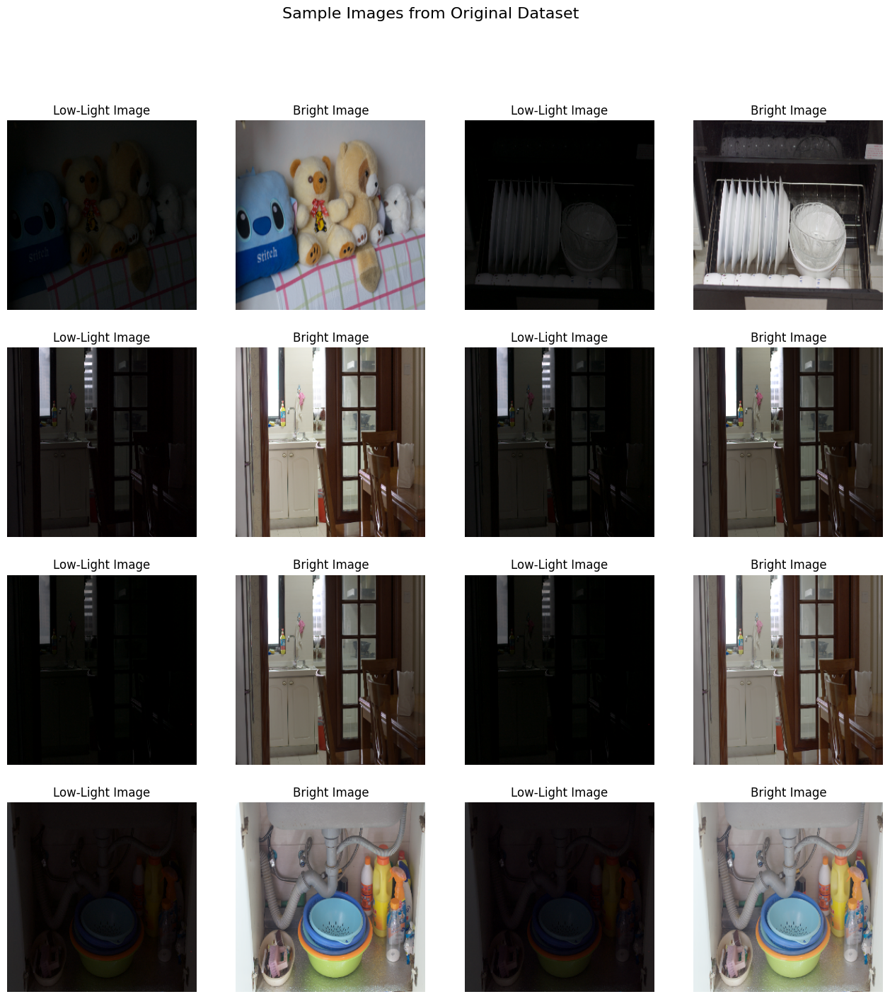

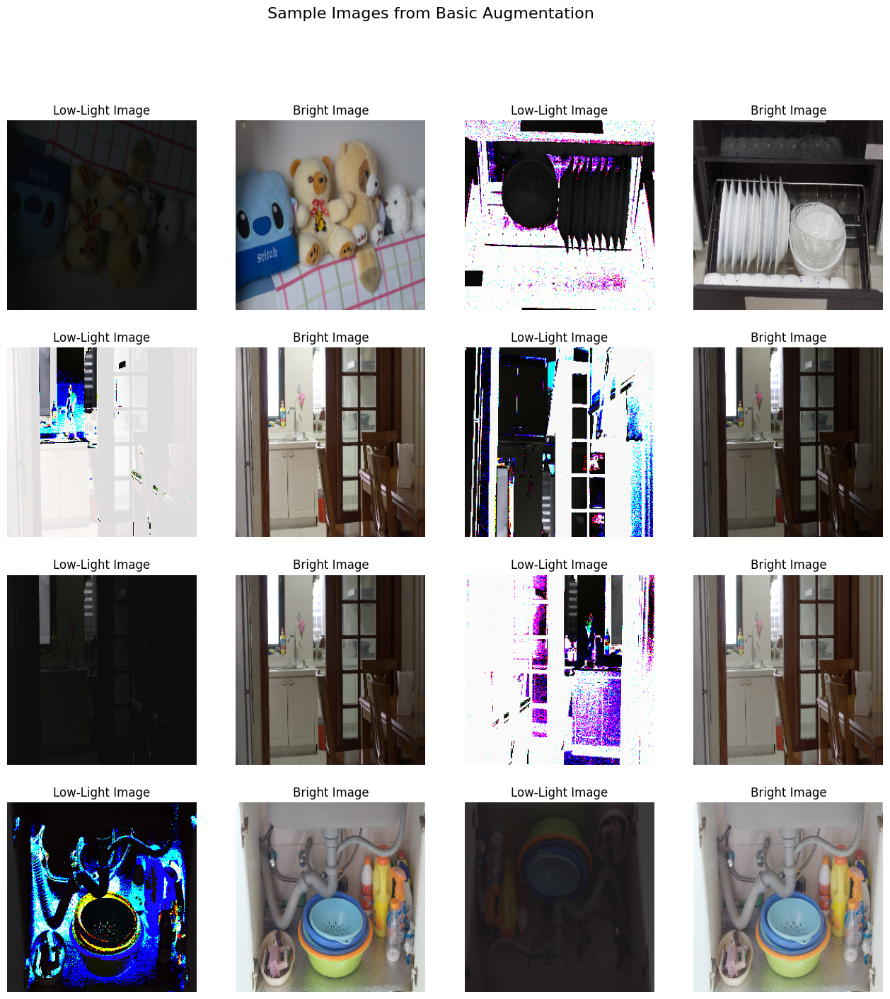

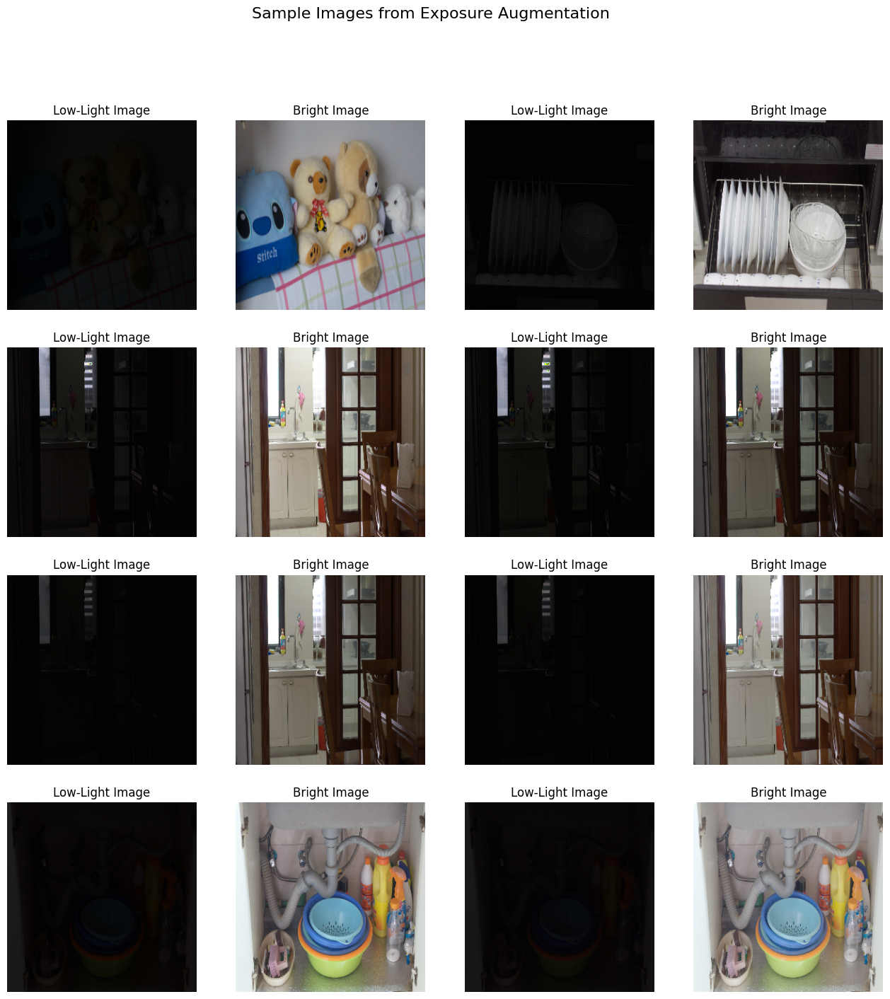

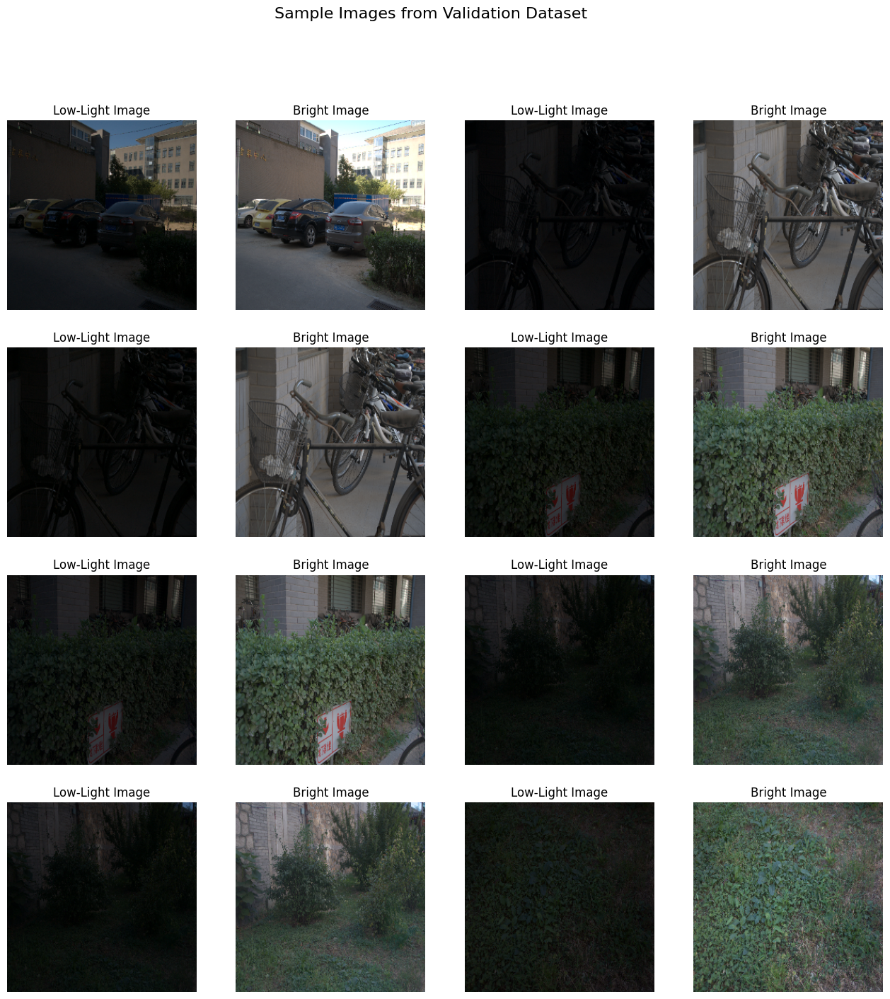

In [8]:
def visualize_sample_images(dataset, title):
    batch = next(iter(dataset))
    
    if isinstance(batch, tuple):  
        # If dataset contains (low-light, bright) pairs
        low_light_images, bright_images = batch
        low_light_images = low_light_images.numpy()
        bright_images = bright_images.numpy()

        fig, axes = plt.subplots(4, 4, figsize=(16, 16))

        for i, ax in enumerate(axes.flat):
            if i % 2 == 0:
                image = low_light_images[i // 2] * 255.0  # Low-light image
                ax.set_title("Low-Light Image")
            else:
                image = bright_images[i // 2] * 255.0  # Corresponding bright image
                ax.set_title("Bright Image")

            ax.imshow(image.astype(np.uint8))
            ax.axis("off")

        plt.suptitle(title, fontsize=16)
        plt.show()

    else:  
        # If dataset contains only single images
        images = batch.numpy()
        fig, axes = plt.subplots(4, 4, figsize=(16, 16))

        for i, ax in enumerate(axes.flat):
            image = images[i] * 255.0  
            ax.imshow(image.astype(np.uint8))
            ax.axis("off")

        plt.suptitle(title, fontsize=16)
        plt.show()

# Visualize datasets
visualize_sample_images(train_dataset_original, "Sample Images from Original Dataset")
visualize_sample_images(train_dataset_basic, "Sample Images from Basic Augmentation")
visualize_sample_images(train_dataset_exposure, "Sample Images from Exposure Augmentation")
visualize_sample_images(val_dataset_original, "Sample Images from Validation Dataset")

**The next part focuses on building the Retinex-Net model which is actually building upon two blocks: decomposition-net and enhancement-net. This code is prepared based on a combination of existing work and the model structure followed for the Zero-DCE model.**

In [9]:
def decomposition_net(input_shape=(None, None, 3)):
    inputs = Input(shape=input_shape)

    # Encoder: Feature extraction
    x = layers.Conv2D(64, (3, 3), padding="same", strides=1)(inputs)
    x = layers.LeakyReLU(negative_slope=0.2)(x)
    x = layers.Conv2D(128, (3, 3), padding="same", strides=1)(x)
    x = layers.LeakyReLU(negative_slope=0.2)(x)
    x = layers.Conv2D(256, (3, 3), padding="same", strides=1)(x)
    x = layers.LeakyReLU(negative_slope=0.2)(x)

    # Decoder: Separate into reflectance and illumination
    reflectance = layers.Conv2D(3, (3, 3), activation="sigmoid", padding="same", name="reflectance")(x)
    illumination = layers.Conv2D(1, (3, 3), activation="sigmoid", padding="same", name="illumination")(x)

    return models.Model(inputs, [reflectance, illumination], name="DecompositionNet")

In [10]:
def enhancement_net(input_shape=(None, None, 1)):
    inputs = layers.Input(shape=input_shape)

    # Encoding (Downsampling)
    x = layers.Conv2D(32, (3, 3), padding="same", strides=2)(inputs)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(64, (3, 3), padding="same", strides=2)(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(128, (3, 3), padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    # Decoding (Upsampling)
    x = layers.Conv2DTranspose(64, (3, 3), padding="same", strides=2)(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2DTranspose(32, (3, 3), padding="same", strides=2)(x)
    x = layers.LeakyReLU(0.2)(x)

    # Output layer
    x = layers.Conv2D(1, (3, 3), activation="sigmoid", padding="same")(x)

    return models.Model(inputs, x, name="EnhancementNet")

In [11]:
class RetinexNet(tf.keras.Model):
    def __init__(self):
        super(RetinexNet, self).__init__()
        self.decomposition = decomposition_net()
        self.enhancement = enhancement_net()

    def call(self, inputs):
        reflectance, illumination = self.decomposition(inputs)
        enhanced_illumination = self.enhancement(illumination)
        enhanced_image = reflectance * enhanced_illumination
        return enhanced_image

In [12]:
def retinex_net_loss(y_true, y_pred):
    reflectance_true, illumination_true = y_true
    reflectance_pred, illumination_pred = y_pred

    # SSIM Loss for preserving structure
    ssim_loss = 1 - tf.image.ssim(reflectance_true, reflectance_pred, max_val=1.0)

    # MSE for Illumination & Reflectance
    reflectance_loss = tf.reduce_mean(tf.square(reflectance_true - reflectance_pred))
    illumination_loss = tf.reduce_mean(tf.square(illumination_true - illumination_pred))

    # Total Variation Loss to smooth illumination
    tv_loss = tf.image.total_variation(illumination_pred)

    return reflectance_loss + illumination_loss + 0.1 * ssim_loss + 0.01 * tf.reduce_mean(tv_loss)

In [13]:
retinex_net = RetinexNet()
retinex_net.build(input_shape=(None, IMAGE_SIZE, IMAGE_SIZE, 3))
retinex_net.summary()

Model: "retinex_net"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ DecompositionNet (Functional)   │ ((None, None, None,    │       380,036 │
│                                 │ 3), (None, None, None, │               │
│                                 │ 1))                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ EnhancementNet (Functional)     │ (None, None, None, 1)  │       185,217 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 565,253 (2.16 MB)

 Trainable params: 565,253 (2.16 MB)

 Non-trainable params: 0 (0.00 B)

In [14]:
class LogPredictionCallback(tf.keras.callbacks.Callback):
    def __init__(self, image_files, high_test_image_files, log_epochs, image_size=256, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.image_files = image_files
        self.high_test_image_files = high_test_image_files
        self.log_epochs = log_epochs
        self.image_size = image_size
        self.loss_history = {"train": {}, "val": {}}

    def preprocess_image(self, image_file):
        """Load and preprocess an image for RetinexNet inference."""
        image = Image.open(image_file).convert("RGB")
        image = image.resize((self.image_size, self.image_size))
        image = np.array(image) / 255.0
        image = tf.convert_to_tensor(image, dtype=tf.float32)
        image = tf.expand_dims(image, axis=0)
        return image

    def infer(self, image_file):
        if self.model is None:
            return None 
        """Run inference on a low-light image and return the enhanced image."""
        input_image = self.preprocess_image(image_file)
        enhanced_image = self.model(input_image, training=False)
        enhanced_image = tf.squeeze(enhanced_image, axis=0).numpy()
        enhanced_image = (enhanced_image * 255).astype(np.uint8)
        return enhanced_image

    def plot_results(self, images, titles, figsize=(12, 6)):
        """Plot low-light, high-quality, and enhanced images side by side."""
        fig, axes = plt.subplots(1, len(images), figsize=figsize)
        for ax, img, title in zip(axes, images, titles):
            ax.imshow(img)
            ax.set_title(title)
            ax.axis("off")
        plt.show()

    def on_epoch_end(self, epoch, logs=None):
        """Log images at specified epochs & track loss."""
        if logs is None:
            logs = {}

        # Store loss values in history
        for key in logs:
            if key not in self.loss_history["train"]:
                self.loss_history["train"][key] = []
            self.loss_history["train"][key].append(logs[key])

        # Structured loss logging
        loss_log = f"Epoch {epoch + 1:02d}/{max(self.log_epochs)} ━━ "
        loss_log += " - ".join([f"{key}: {logs[key]:.4f}" for key in logs.keys()])
        #print(loss_log)

        # Log images only at specified epochs
        if (epoch + 1) in self.log_epochs:

            for low_light_file, high_test_file in zip(self.image_files, self.high_test_image_files):
                low_light_image = Image.open(low_light_file).convert("RGB")
                high_quality_image = Image.open(high_test_file).convert("RGB")
                enhanced_image = self.infer(low_light_file)  # Get enhanced result

                self.plot_results(
                    [low_light_image, high_quality_image, enhanced_image],
                    ["Low-Light", "Ground-Truth", "Enhanced"],
                    (18, 6),
                )

    def on_train_end(self, logs=None):
        """Plot training & validation loss at the end of training."""
        epochs = range(1, len(next(iter(self.loss_history["train"].values()))) + 1)
        plt.figure(figsize=(8, 5))

        for key in self.loss_history["train"]:
            plt.plot(epochs, self.loss_history["train"][key], label=f"Train {key}")
        for key in self.loss_history["val"]:
            plt.plot(epochs, self.loss_history["val"][key], linestyle="dashed", label=f"Val {key}")

        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()
        plt.title("Training & Validation Loss Over Time")
        plt.show()

Epoch 1/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0335

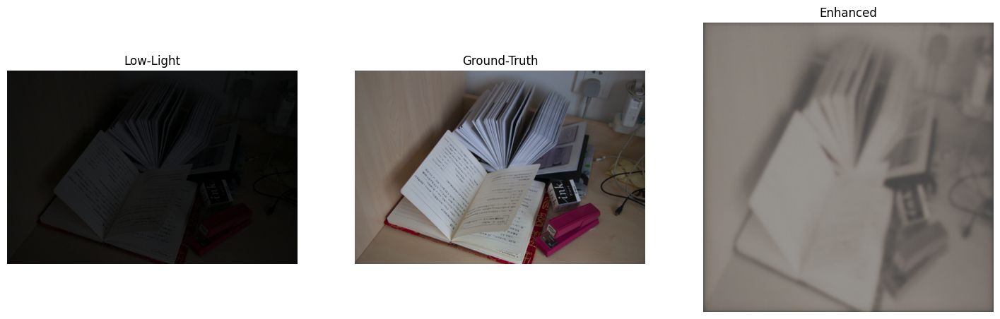

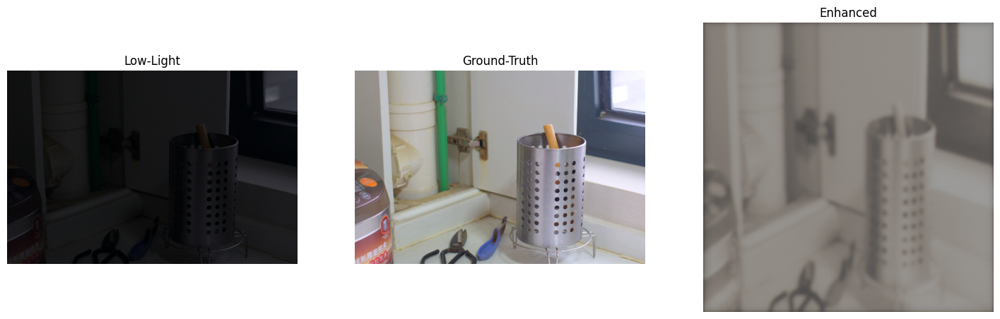

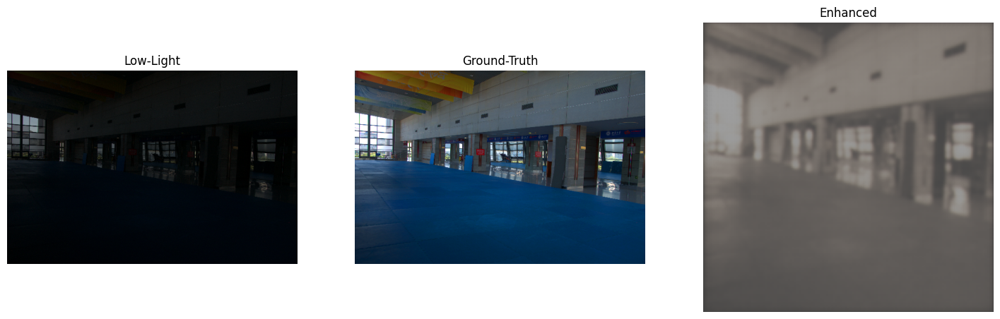

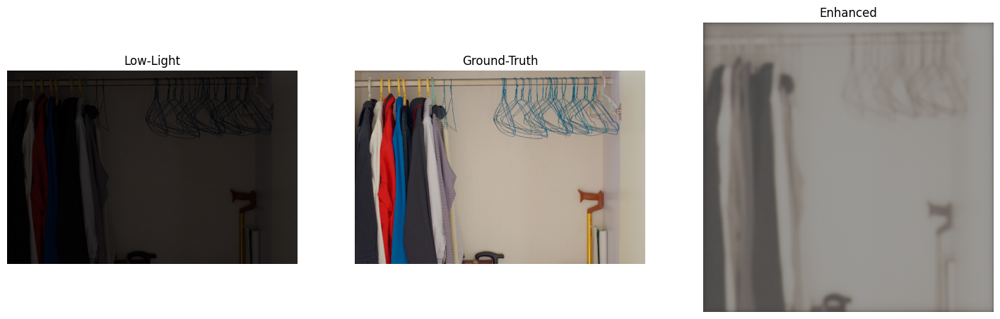

25/25 ━━━━━━━━━━━━━━━━━━━━ 135s 5s/step - loss: 0.0335 - val_loss: 0.0287
Epoch 2/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0344 - val_loss: 0.0314
Epoch 3/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 135s 5s/step - loss: 0.0327 - val_loss: 0.0304
Epoch 4/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0329 - val_loss: 0.0303
Epoch 5/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0328 - val_loss: 0.0303
Epoch 6/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 134s 5s/step - loss: 0.0325 - val_loss: 0.0302
Epoch 7/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 139s 6s/step - loss: 0.0322 - val_loss: 0.0300
Epoch 8/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 137s 5s/step - loss: 0.0319 - val_loss: 0.0298
Epoch 9/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 132s 5s/step - loss: 0.0317 - val_loss: 0.0296
Epoch 10/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 132s 5s/step - loss: 0.0315 - val_loss: 0.0293
Epoch 11/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0315

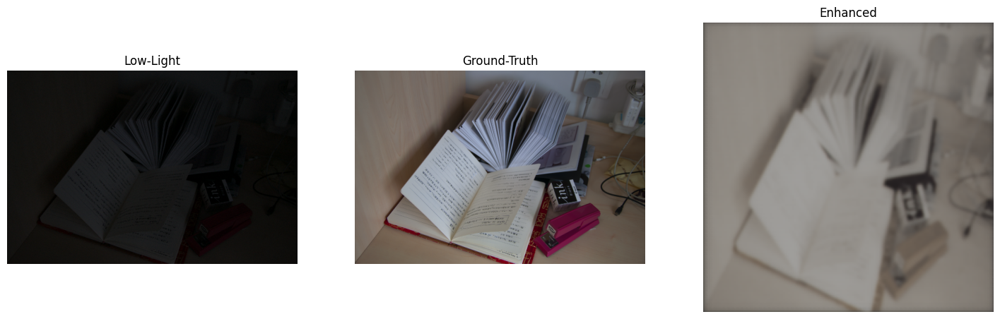

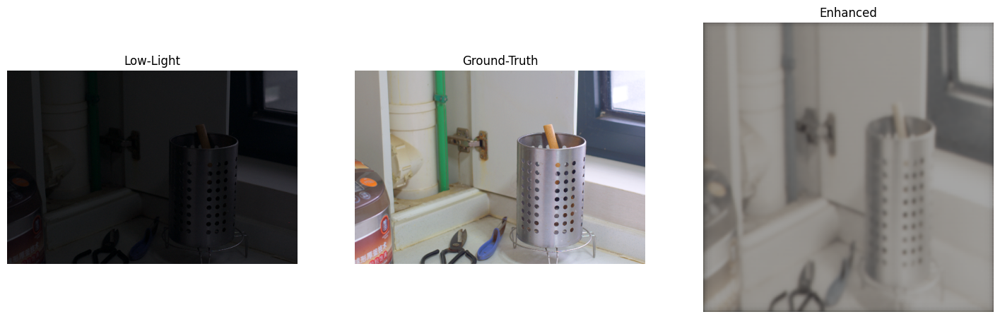

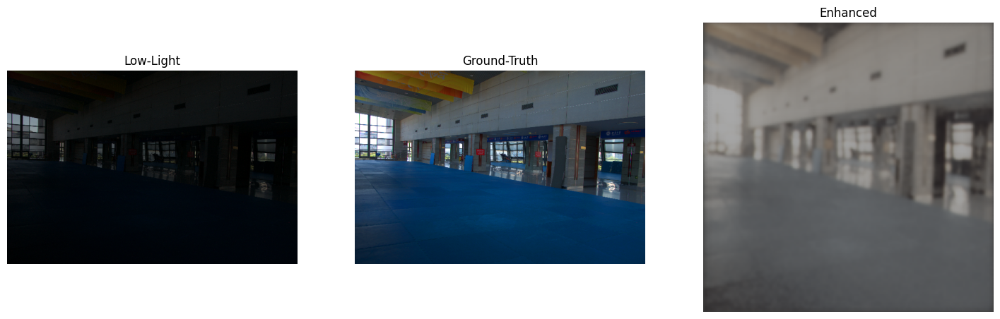

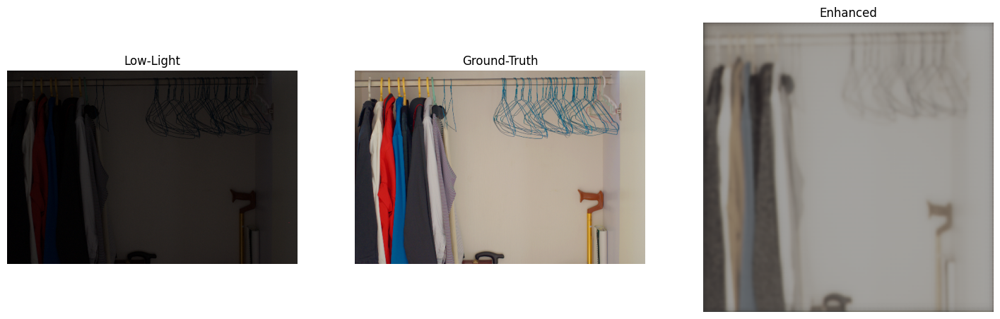

25/25 ━━━━━━━━━━━━━━━━━━━━ 135s 5s/step - loss: 0.0314 - val_loss: 0.0290
Epoch 12/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 128s 5s/step - loss: 0.0312 - val_loss: 0.0286
Epoch 13/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 131s 5s/step - loss: 0.0310 - val_loss: 0.0281
Epoch 14/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 133s 5s/step - loss: 0.0309 - val_loss: 0.0277
Epoch 15/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 132s 5s/step - loss: 0.0307 - val_loss: 0.0273
Epoch 16/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 131s 5s/step - loss: 0.0305 - val_loss: 0.0270
Epoch 17/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 132s 5s/step - loss: 0.0304 - val_loss: 0.0268
Epoch 18/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 130s 5s/step - loss: 0.0303 - val_loss: 0.0267
Epoch 19/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 132s 5s/step - loss: 0.0301 - val_loss: 0.0267
Epoch 20/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 132s 5s/step - loss: 0.0300 - val_loss: 0.0267
Epoch 21/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0300

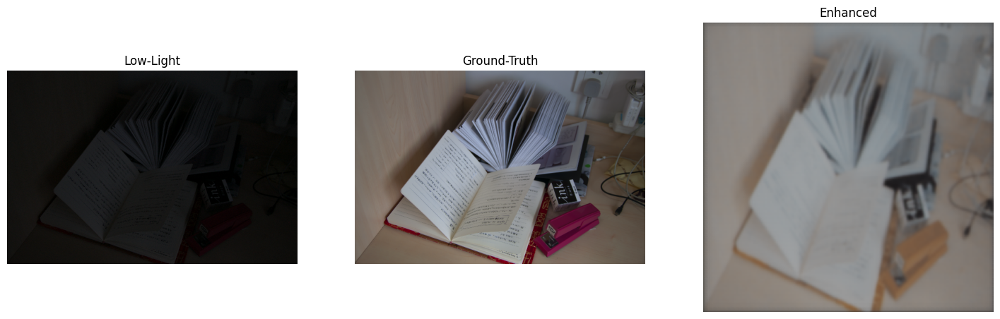

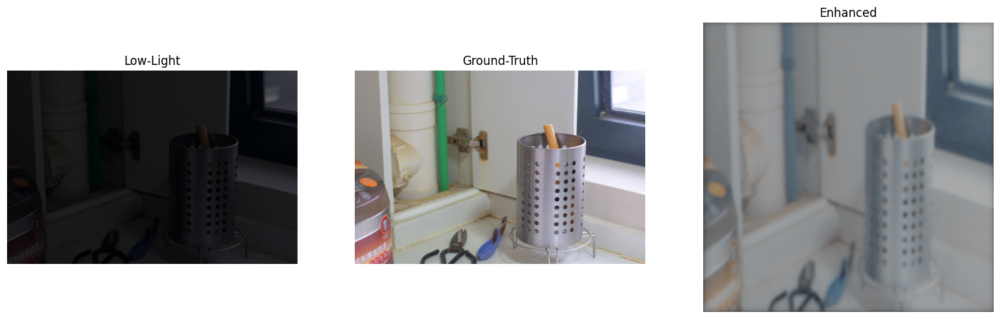

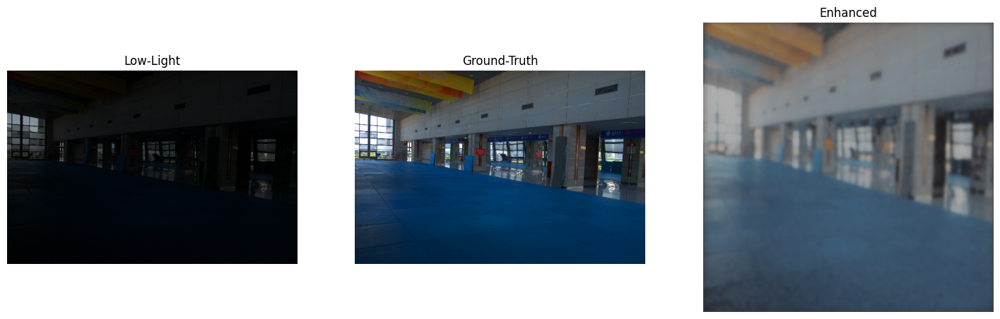

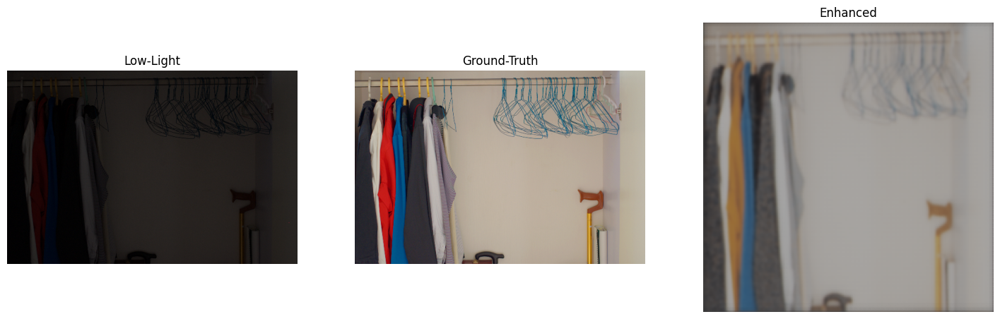

25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0299 - val_loss: 0.0266
Epoch 22/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0298 - val_loss: 0.0266
Epoch 23/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0297 - val_loss: 0.0265
Epoch 24/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0296 - val_loss: 0.0265
Epoch 25/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0295 - val_loss: 0.0264
Epoch 26/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0294 - val_loss: 0.0263
Epoch 27/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0293 - val_loss: 0.0262
Epoch 28/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0292 - val_loss: 0.0261
Epoch 29/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0291 - val_loss: 0.0260
Epoch 30/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0290 - val_loss: 0.0259


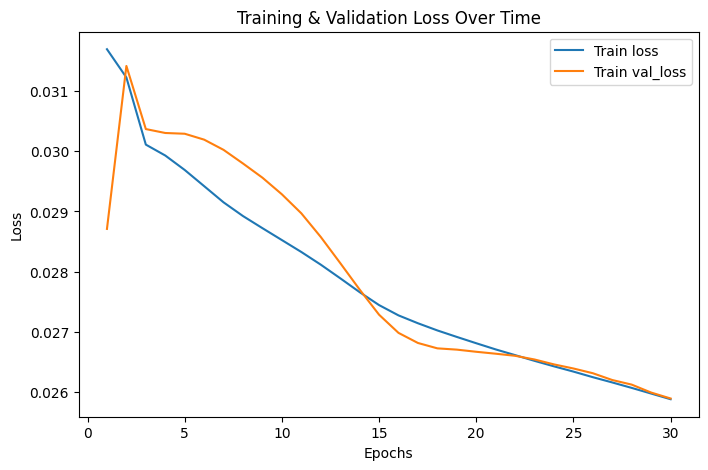

In [16]:
# Training the model using the original dataset
retinex_net.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
    loss=tf.keras.losses.MeanSquaredError()
)

test_image_files = ["./lol_dataset/eval15/low/547.png", "./lol_dataset/eval15/low/111.png", "./lol_dataset/eval15/low/780.png", "./lol_dataset/eval15/low/146.png"]
high_test_image_files = ["./lol_dataset/eval15/high/547.png", "./lol_dataset/eval15/high/111.png", "./lol_dataset/eval15/high/780.png", "./lol_dataset/eval15/high/146.png"]

log_callback = LogPredictionCallback(
    image_files=test_image_files,
    high_test_image_files=high_test_image_files,
    log_epochs=[1, 11, 21],  # Log these epochs
)

history = retinex_net.fit(
    train_dataset_original,
    validation_data=val_dataset_original,
    epochs=30,
    callbacks=[log_callback]
)

Epoch 1/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.1285

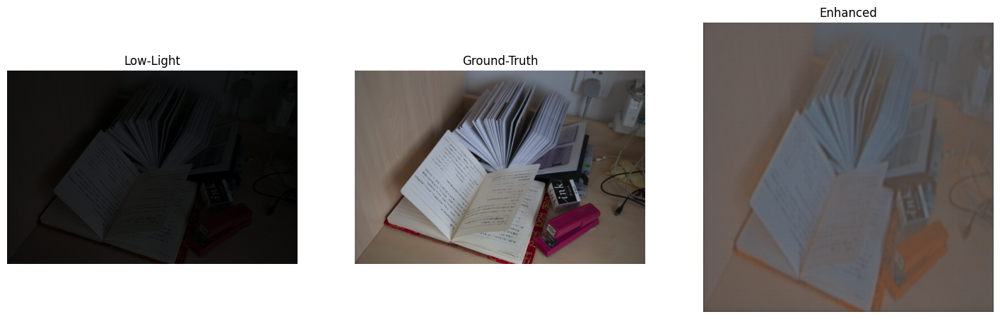

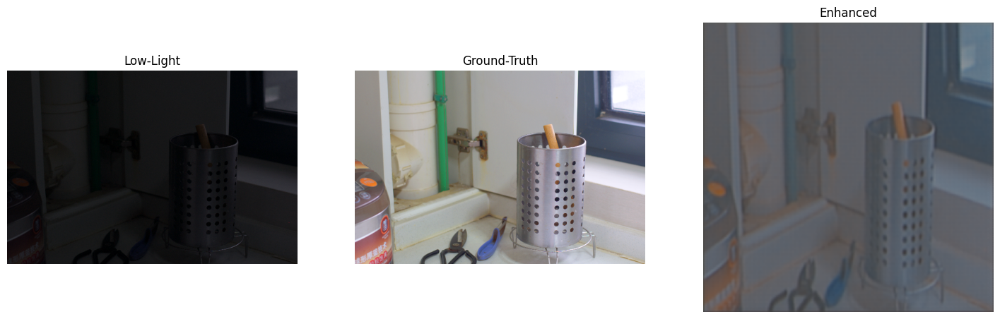

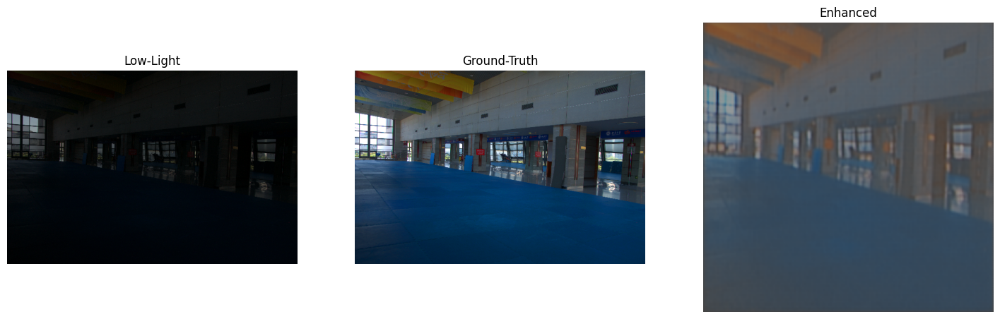

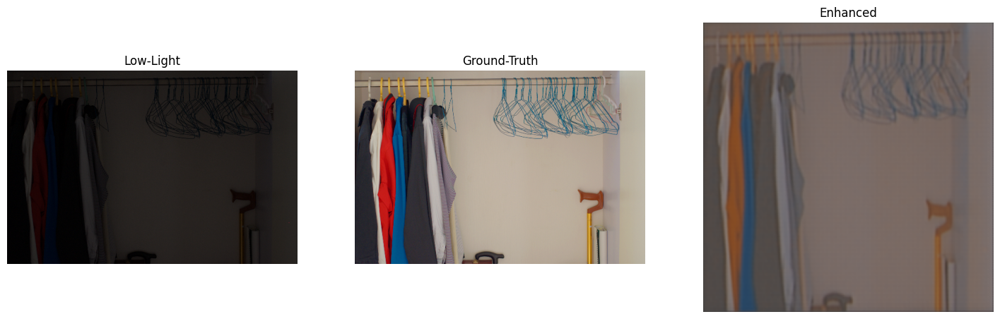

25/25 ━━━━━━━━━━━━━━━━━━━━ 129s 5s/step - loss: 0.1281 - val_loss: 0.0533
Epoch 2/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0752 - val_loss: 0.0410
Epoch 3/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 122s 5s/step - loss: 0.0536 - val_loss: 0.0395
Epoch 4/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 123s 5s/step - loss: 0.0503 - val_loss: 0.0406
Epoch 5/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0500 - val_loss: 0.0386
Epoch 6/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0511 - val_loss: 0.0410
Epoch 7/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0492 - val_loss: 0.0398
Epoch 8/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0487 - val_loss: 0.0403
Epoch 9/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0487 - val_loss: 0.0401
Epoch 10/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 213s 9s/step - loss: 0.0487 - val_loss: 0.0411
Epoch 11/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0478

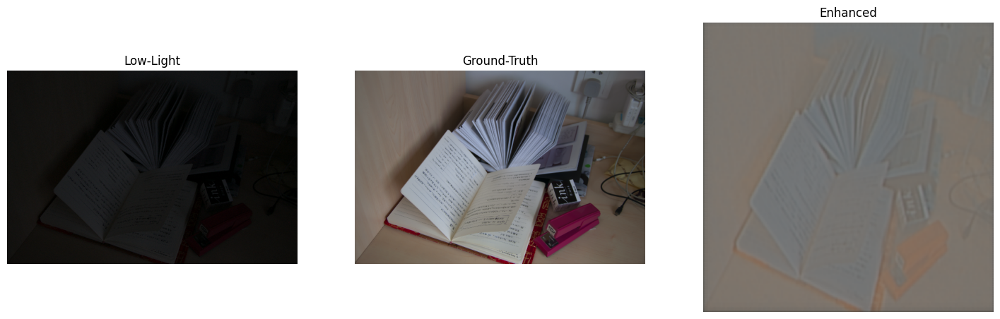

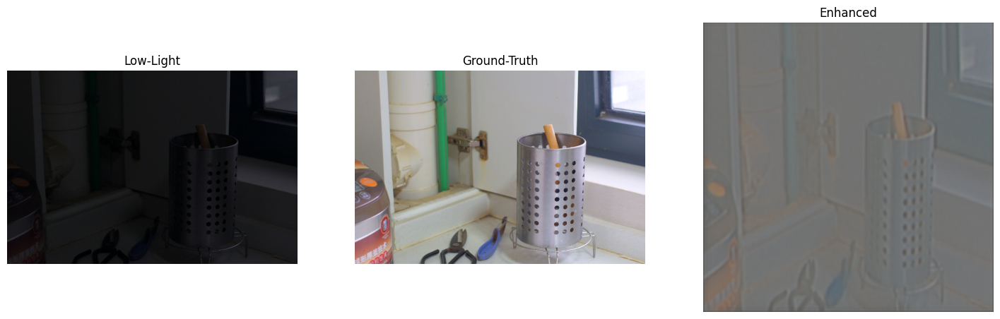

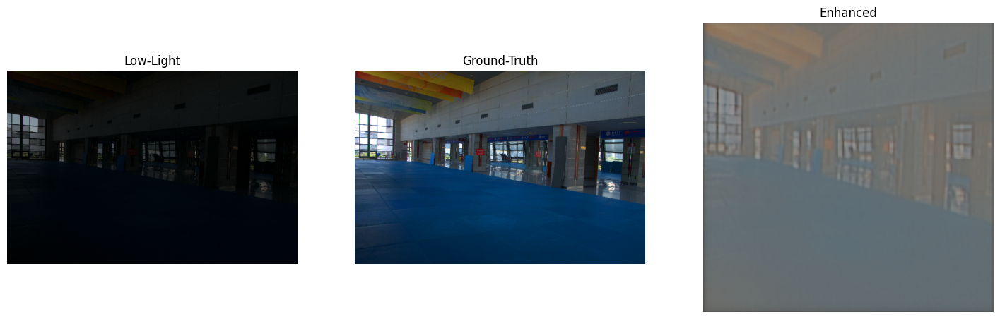

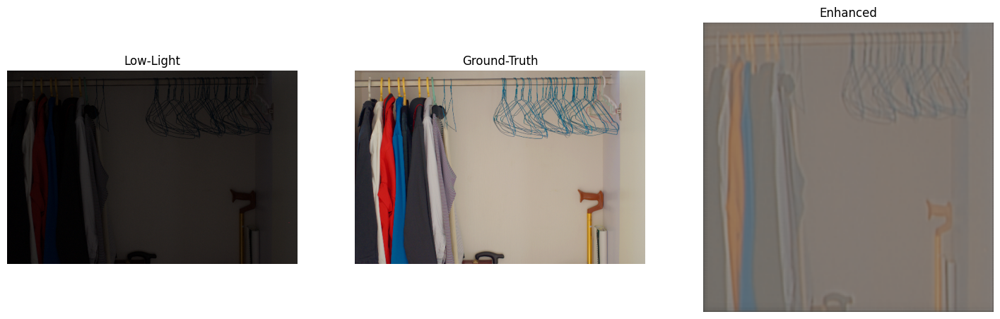

25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0478 - val_loss: 0.0409
Epoch 12/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0487 - val_loss: 0.0412
Epoch 13/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0485 - val_loss: 0.0411
Epoch 14/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0485 - val_loss: 0.0412
Epoch 15/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0480 - val_loss: 0.0407
Epoch 16/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0482 - val_loss: 0.0410
Epoch 17/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0479 - val_loss: 0.0413
Epoch 18/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0481 - val_loss: 0.0415
Epoch 19/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0481 - val_loss: 0.0409
Epoch 20/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0482 - val_loss: 0.0413
Epoch 21/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0482

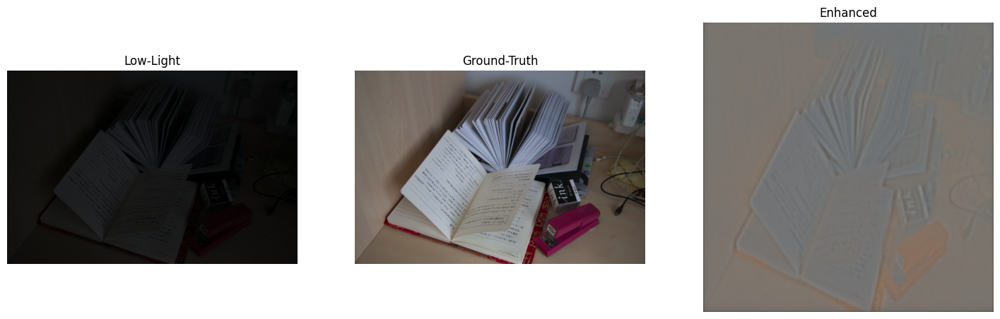

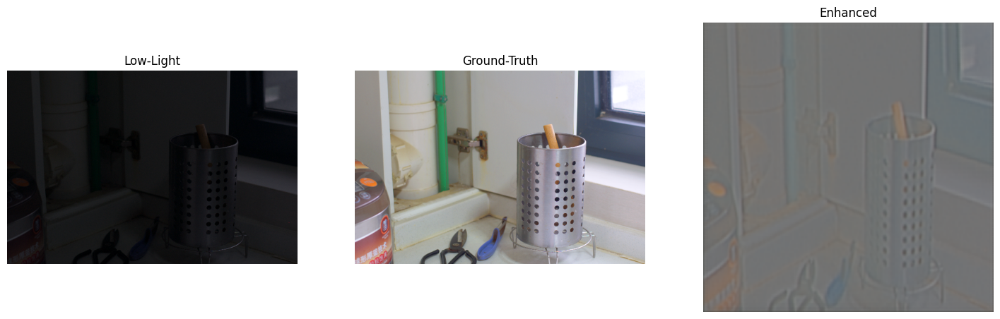

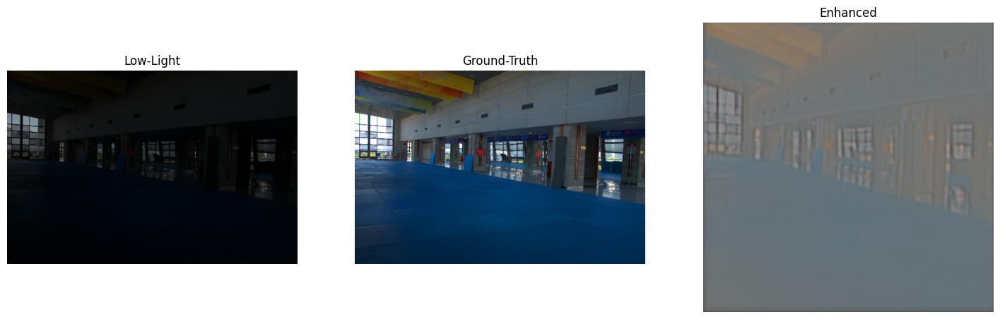

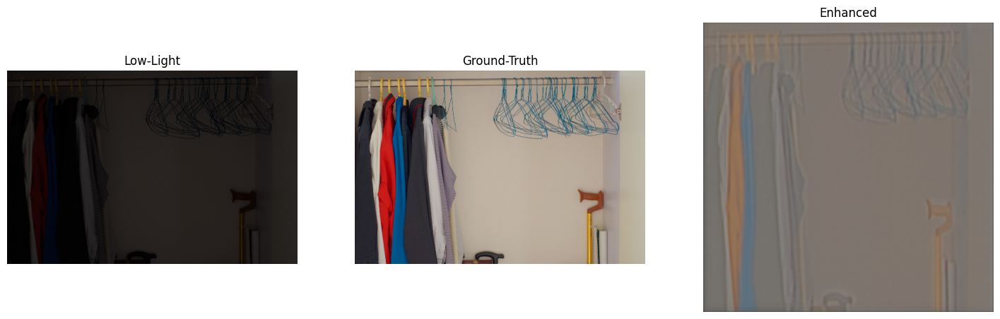

25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0482 - val_loss: 0.0410
Epoch 22/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0481 - val_loss: 0.0411
Epoch 23/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 127s 5s/step - loss: 0.0479 - val_loss: 0.0417
Epoch 24/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 130s 5s/step - loss: 0.0480 - val_loss: 0.0414
Epoch 25/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 131s 5s/step - loss: 0.0481 - val_loss: 0.0410
Epoch 26/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 134s 5s/step - loss: 0.0480 - val_loss: 0.0410
Epoch 27/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 133s 5s/step - loss: 0.0477 - val_loss: 0.0411
Epoch 28/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 138s 6s/step - loss: 0.0480 - val_loss: 0.0416
Epoch 29/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 141s 6s/step - loss: 0.0479 - val_loss: 0.0412
Epoch 30/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 139s 6s/step - loss: 0.0479 - val_loss: 0.0409


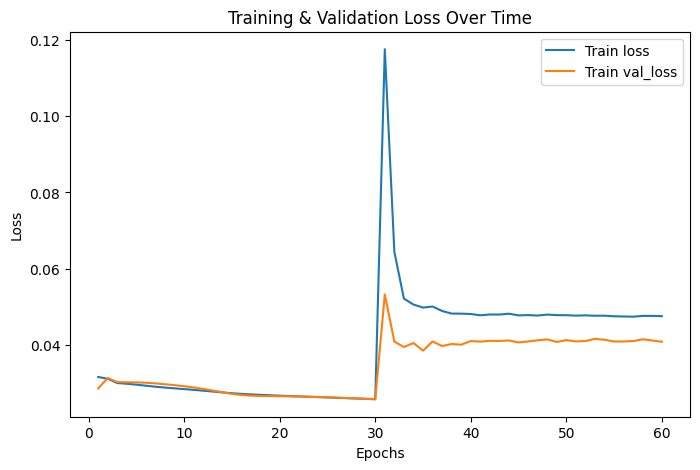

In [17]:
# Training the model using the dataset with basic augmentation
history_basic = retinex_net.fit(
    train_dataset_basic,
    validation_data=val_dataset_basic,
    epochs=30,
    callbacks=[log_callback]
)

Epoch 1/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0454

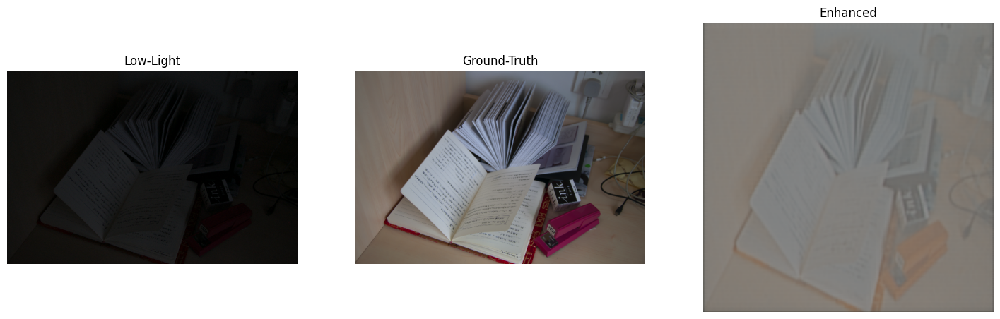

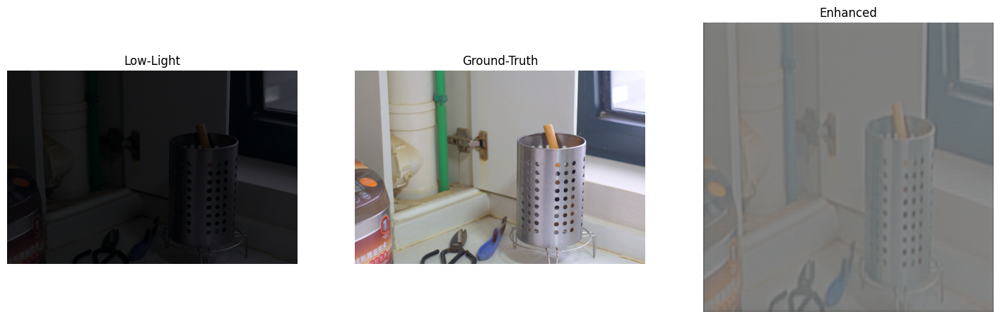

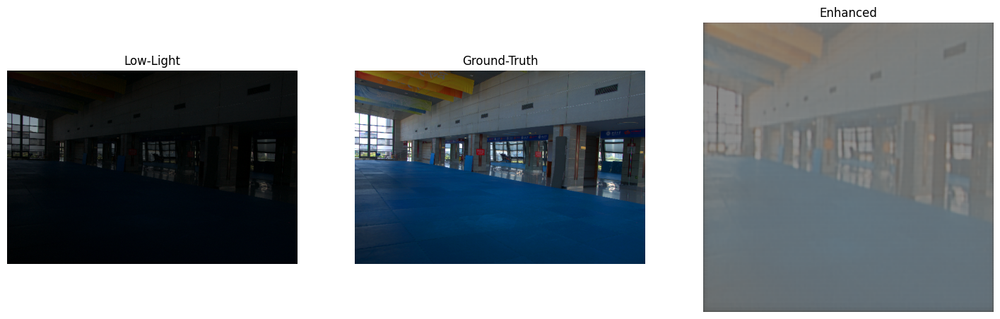

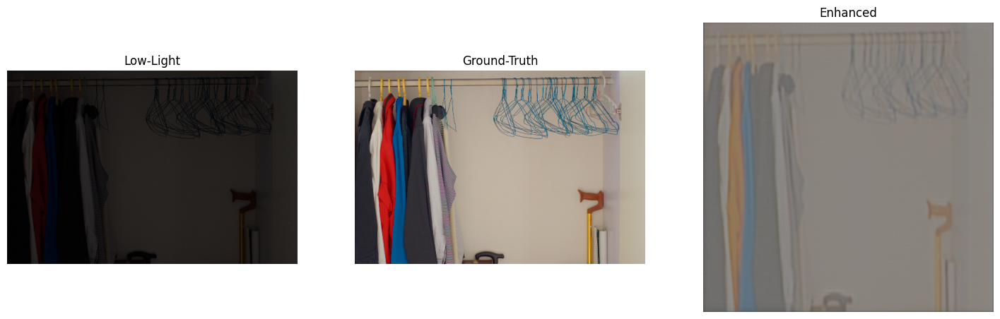

25/25 ━━━━━━━━━━━━━━━━━━━━ 133s 5s/step - loss: 0.0453 - val_loss: 0.0447
Epoch 2/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 139s 6s/step - loss: 0.0418 - val_loss: 0.0480
Epoch 3/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 137s 5s/step - loss: 0.0395 - val_loss: 0.0545
Epoch 4/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 139s 6s/step - loss: 0.0367 - val_loss: 0.0681
Epoch 5/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 135s 5s/step - loss: 0.0344 - val_loss: 0.0765
Epoch 6/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 138s 6s/step - loss: 0.0335 - val_loss: 0.0805
Epoch 7/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 134s 5s/step - loss: 0.0333 - val_loss: 0.0819
Epoch 8/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0330 - val_loss: 0.0821
Epoch 9/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 140s 6s/step - loss: 0.0333 - val_loss: 0.0817
Epoch 10/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 140s 6s/step - loss: 0.0329 - val_loss: 0.0816
Epoch 11/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0327

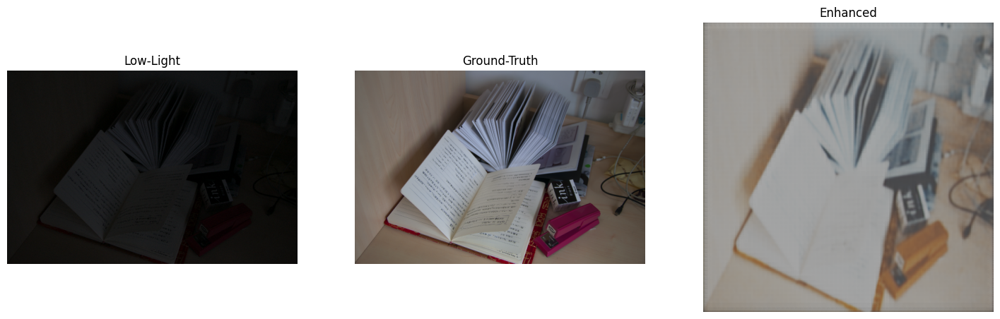

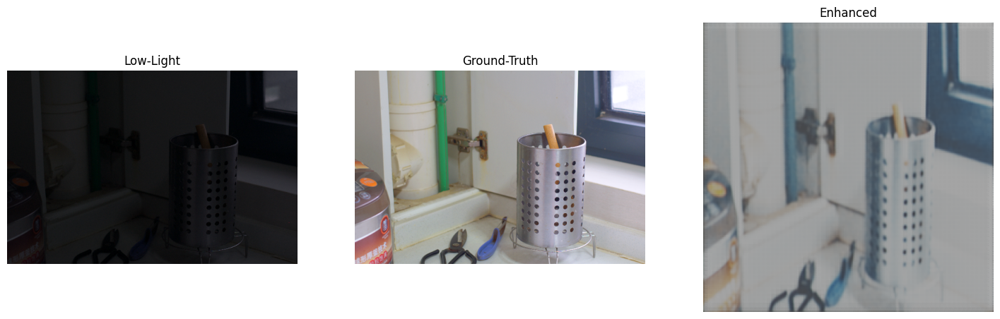

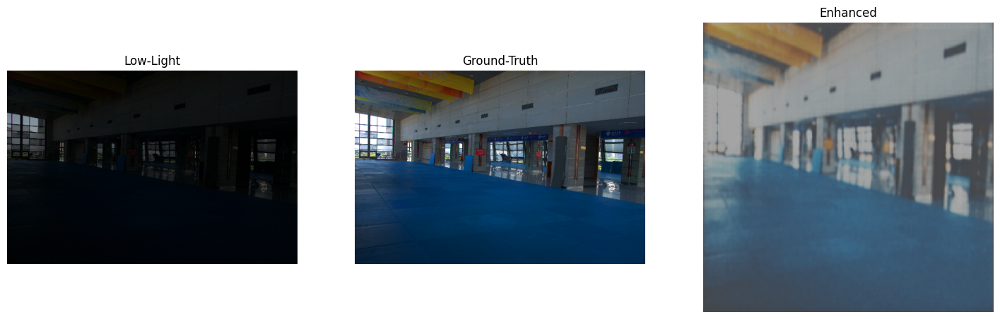

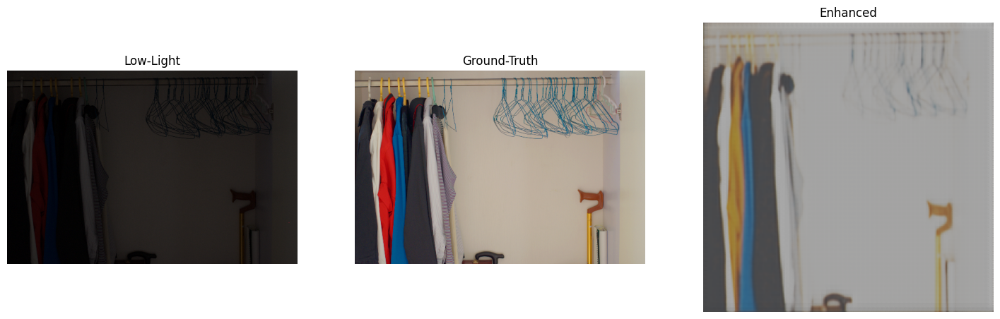

25/25 ━━━━━━━━━━━━━━━━━━━━ 138s 6s/step - loss: 0.0326 - val_loss: 0.0803
Epoch 12/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0326 - val_loss: 0.0823
Epoch 13/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 136s 5s/step - loss: 0.0324 - val_loss: 0.0825
Epoch 14/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 143s 6s/step - loss: 0.0320 - val_loss: 0.0809
Epoch 15/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 144s 6s/step - loss: 0.0321 - val_loss: 0.0812
Epoch 16/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 140s 6s/step - loss: 0.0322 - val_loss: 0.0817
Epoch 17/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 146s 6s/step - loss: 0.0319 - val_loss: 0.0802
Epoch 18/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 137s 5s/step - loss: 0.0320 - val_loss: 0.0810
Epoch 19/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 137s 5s/step - loss: 0.0315 - val_loss: 0.0802
Epoch 20/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 139s 6s/step - loss: 0.0316 - val_loss: 0.0811
Epoch 21/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0317

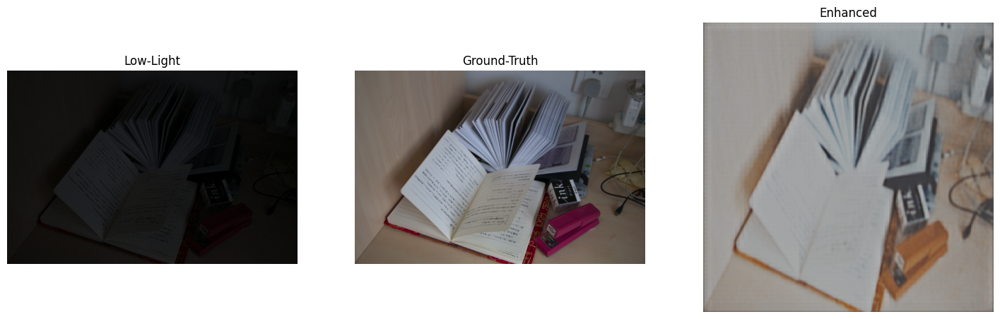

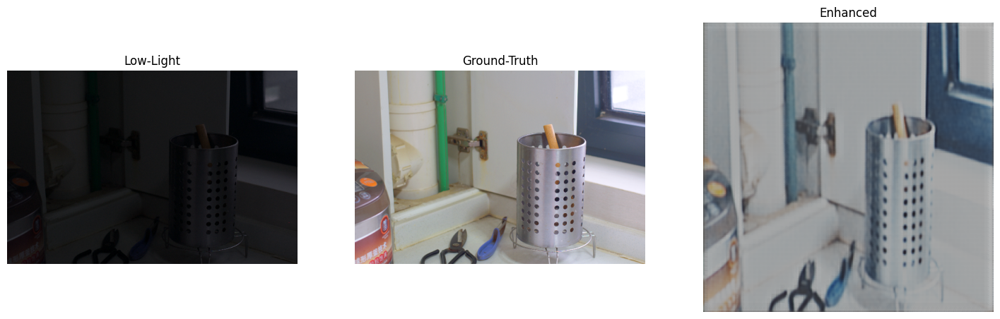

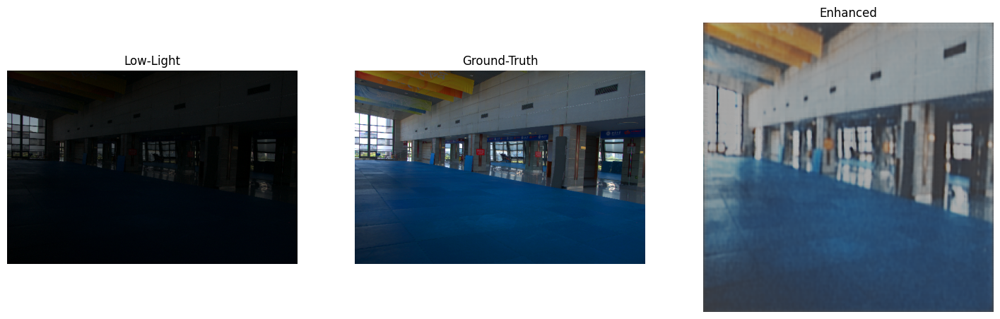

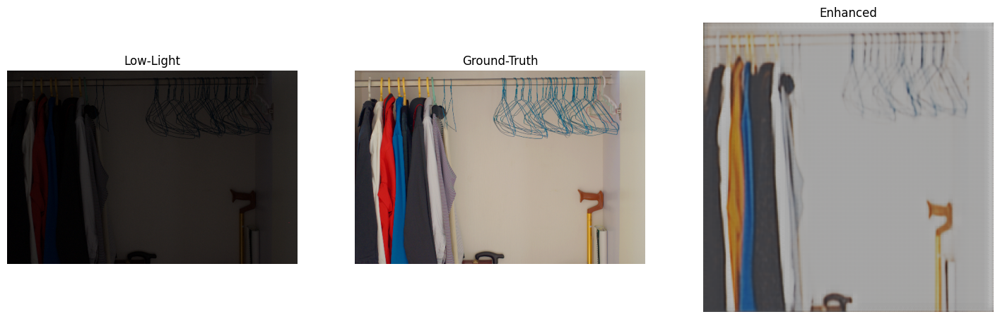

25/25 ━━━━━━━━━━━━━━━━━━━━ 131s 5s/step - loss: 0.0315 - val_loss: 0.0806
Epoch 22/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 128s 5s/step - loss: 0.0314 - val_loss: 0.0804
Epoch 23/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - loss: 0.0314 - val_loss: 0.0807
Epoch 24/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0312 - val_loss: 0.0810
Epoch 25/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0311 - val_loss: 0.0796
Epoch 26/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0312 - val_loss: 0.0815
Epoch 27/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 124s 5s/step - loss: 0.0304 - val_loss: 0.0812
Epoch 28/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0306 - val_loss: 0.0802
Epoch 29/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - loss: 0.0306 - val_loss: 0.0811
Epoch 30/30
25/25 ━━━━━━━━━━━━━━━━━━━━ 129s 5s/step - loss: 0.0304 - val_loss: 0.0816


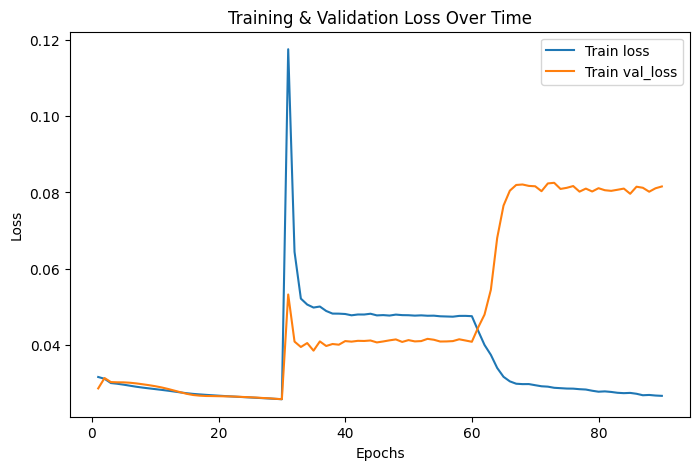

In [18]:
# Training the model using the dataset with exposure augmentations
history_exposure = retinex_net.fit(
    train_dataset_exposure,
    validation_data=val_dataset_exposure,
    epochs=30,
    callbacks=[log_callback]
)

In [19]:
retinex_net.save("models/retinex_net.keras")